In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from datetime import datetime, timedelta, date, time
import seaborn as sns
import matplotlib.dates as mdates
import operator
import ssl
import urllib
import json
from haversine import haversine, Unit
import folium











---

In [37]:
sns.set_theme()

### Import the data

Trip data (already formatted and outliers have been removed, please refer to Preprocessing.ipynb)

In [2]:
df_bonn = pd.read_pickle("data/df_bonn.pickle")
df_essen = pd.read_pickle("data/df_essen.pickle")

In [3]:
# Create a weekday dictonary to show the weekday names in the plots
weekdays = {
    0: "Monday",
    1: "Tuesday",
    2: "Wednesday",
    3: "Thursday",
    4: "Friday",
    5: "Saturday",
    6: "Sunday"
}

In [4]:
# Create a season dictonary to show the season names in the plots
seasons = {
    0: "Winter",
    1: "Spring",
    2: "Summer",
    3: "Autumn",
}

Import API data

In [5]:
context = ssl._create_unverified_context()

def request(city_id):
    response = urllib.request.urlopen(f"https://api.nextbike.net/maps/nextbike-live.json?city={city_id}", context=context)
    response = response.read().decode("utf-8")
    return json.loads(response)

bonn_json = request(547)["countries"][0]["cities"][0] # Bonn city ID at NextBike is 547
essen_json = request(133)["countries"][0]["cities"][0] # Essen city ID at NextBike ist 133

In [6]:
# Use as center points for maps:
bonn_center = np.array([bonn_json["lat"], bonn_json["lng"]])
essen_center = np.array([essen_json["lat"], essen_json["lng"]])

Weather data

In [7]:
# Import weather data
df_weather_bonn = pd.read_pickle("data/df_weather_bonn.pickle")
df_weather_essen = pd.read_pickle("data/df_weather_essen.pickle")

---

In [8]:
df_bonn.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 329312 entries, 0 to 329311
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype          
---  ------         --------------   -----          
 0   day            329312 non-null  object         
 1   time           329312 non-null  object         
 2   b_number       329312 non-null  int64          
 3   city           329312 non-null  object         
 4   trip_duration  329312 non-null  timedelta64[ns]
 5   timestamp      329312 non-null  datetime64[ns] 
 6   weekday        329312 non-null  int64          
 7   hour           329312 non-null  int64          
 8   season         329312 non-null  int64          
 9   orig           329312 non-null  object         
 10  dest           329312 non-null  object         
dtypes: datetime64[ns](1), int64(4), object(5), timedelta64[ns](1)
memory usage: 27.6+ MB


<h2> Utilization KPI <h2>


#### Key Question 


How high is the utilization of the bike fleet? 

### Data preparation

Create all needed Data to determine KPI for both cities:
* bike\_usage\_*city* - Dataframe with information about the first and last trip of every bike. Used to calculate fleet size.
* daily\_uilization\_*city* - Dataframe with daily data about fleet size, maximum capacity of trips in minutes, trip minutes of fleet and utilization rate.
* hourly\_uilization\_*city* - Dataframe with daily data about fleet size, maximum capacity of trips in minutes, trip minutes of fleet and utilization rate.

#### Bonn

In [9]:
# Create dataframe with date of first and last trip of every bike rented in Bonn

#get all bikes used per City 
bike_usage_bonn = pd.DataFrame(columns = ['b_number', 'first_trip', 'last_trip', 'unique_days_used', 'total_days'])

bike_usage_bonn['b_number'] = df_bonn['b_number'].unique()

bike_usage_bonn.set_index('b_number', inplace=True)

#get first trip date 
bike_usage_bonn['first_trip'] = df_bonn.groupby('b_number')['timestamp'].agg('min')
bike_usage_bonn['first_trip'] = bike_usage_bonn['first_trip'].apply(lambda row: row.normalize())

#get last trip
bike_usage_bonn['last_trip'] = df_bonn.groupby('b_number')['timestamp'].agg('max')
bike_usage_bonn['last_trip'] = bike_usage_bonn['last_trip'].apply(lambda row: row.normalize())

# unique days used

bike_usage_bonn['unique_days_used'] = df_bonn.groupby('b_number')['day'].nunique()


#total days between first and last trip
bike_usage_bonn['total_days'] = bike_usage_bonn['last_trip'] - bike_usage_bonn['first_trip']
bike_usage_bonn['total_days'] = bike_usage_bonn['total_days'].dt.days



In [10]:
#Creating hourly_utilization_bonn 

daily_utilization_bonn = pd.DataFrame(columns = ['timestamp', 'fleet', 'max_capacity', 'utilization','capacity_utilization_rate', 'weekday', 'season'])

# timestamps as day
daily_utilization_bonn['timestamp'] = df_bonn['timestamp'].dt.normalize().unique()

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (daily_utilization_bonn.shape[0]-1):
   daily_utilization_bonn['fleet'][i] = bike_usage_bonn[(daily_utilization_bonn['timestamp'][i]>= bike_usage_bonn['first_trip']) & (bike_usage_bonn['last_trip'] >= daily_utilization_bonn['timestamp'][i])].shape[0]
daily_utilization_bonn['fleet'] = daily_utilization_bonn["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
daily_utilization_bonn['max_capacity'] = daily_utilization_bonn['fleet']*24 * 60

# rent time in minutes
daily_trip_duration_bonn = df_bonn.groupby(pd.Grouper(key='timestamp', freq='D'))['trip_duration'].agg('sum').reset_index()
daily_utilization_bonn['utilization'] = daily_trip_duration_bonn.loc[daily_trip_duration_bonn['trip_duration'].dt.seconds != 0].reset_index()['trip_duration']
daily_utilization_bonn['utilization'] = (daily_utilization_bonn['utilization'].dt.days * 1440) + (daily_utilization_bonn['utilization'].dt.seconds / 60)

# capacity utilization rate 
daily_utilization_bonn['capacity_utilization_rate'] = pd.to_numeric(100 * daily_utilization_bonn['utilization'] / daily_utilization_bonn['max_capacity'])

# add weekdays and season
daily_utilization_bonn['weekday'] = daily_utilization_bonn["timestamp"].apply(lambda row: row.weekday())
daily_utilization_bonn["season"] = daily_utilization_bonn["timestamp"].apply(lambda row: row.month%12 // 3)



In [11]:
#Creating hourly_utilization_bonn 

hourly_utilization_bonn = pd.DataFrame(columns =['timestamp', 'hour', 'trips','fleet', 'utilization' ,'capacity_utilization_rate', 'idle_time', 'idle_time_rate', 'weekday', 'season'])

# timestamps as day
hourly_utilization_bonn['timestamp'] = hourly_utilization_bonn['timestamp'] 
hourly_utilization_bonn['timestamp'] = df_bonn['timestamp'].dt.normalize()
hourly_utilization_bonn['hour'] = df_bonn['hour']


hourly_utilization_bonn['utilization'] = df_bonn['trip_duration']
hourly_utilization_bonn = hourly_utilization_bonn.groupby(['timestamp', 'hour']).agg('sum').dropna().reset_index()
hourly_utilization_bonn['utilization'] = hourly_utilization_bonn['utilization'].dt.seconds / 60

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (hourly_utilization_bonn.shape[0]-1):
   hourly_utilization_bonn['fleet'][i] = bike_usage_bonn[(hourly_utilization_bonn['timestamp'][i]>= bike_usage_bonn['first_trip']) & (bike_usage_bonn['last_trip'] >= hourly_utilization_bonn['timestamp'][i])].shape[0]
hourly_utilization_bonn['fleet'] = hourly_utilization_bonn["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
hourly_utilization_bonn['max_capacity'] = hourly_utilization_bonn['fleet'] * 60

# capacity utilization rate = % 
hourly_utilization_bonn['capacity_utilization_rate'] = pd.to_numeric(100 * hourly_utilization_bonn['utilization'] / hourly_utilization_bonn['max_capacity'])

# add weekdays and season
hourly_utilization_bonn['weekday'] = hourly_utilization_bonn["timestamp"].apply(lambda row: row.weekday())
hourly_utilization_bonn["season"] = hourly_utilization_bonn["timestamp"].apply(lambda row: row.month%12 // 3)
hourly_utilization_bonn = hourly_utilization_bonn.replace([np.inf, -np.inf], 0)
#daily_utilization_bonn = daily_utilization_bonn.set_index('timestamp')

#### Essen

In [12]:
# Create dataframe with date of first and last trip of every bike rented in Essen

#get all bikes rented in Essen 
bike_usage_essen = pd.DataFrame(columns = ['b_number', 'first_trip', 'last_trip',  'unique_days_used', 'total_days'])

bike_usage_essen['b_number'] = df_essen['b_number'].unique()

bike_usage_essen.set_index('b_number', inplace=True)

#get first trip date 
bike_usage_essen['first_trip'] = df_essen.groupby('b_number')['timestamp'].agg('min')
bike_usage_essen['first_trip'] = bike_usage_essen['first_trip'].apply(lambda row: row.normalize())

#get last trip
bike_usage_essen['last_trip'] = df_essen.groupby('b_number')['timestamp'].agg('max')
bike_usage_essen['last_trip'] = bike_usage_essen['last_trip'].apply(lambda row: row.normalize())

# unique days used

bike_usage_essen['unique_days_used'] = df_essen.groupby('b_number')['day'].nunique()


#total days between first and last trip
bike_usage_essen['total_days'] = bike_usage_essen['last_trip'] - bike_usage_essen['first_trip']
bike_usage_essen['total_days'] = bike_usage_essen['total_days'].dt.days

In [13]:
# Create dataframe daily_utilization_essen


daily_utilization_essen = pd.DataFrame(columns = ['timestamp', 'fleet', 'max_capacity', 'utilization','capacity_utilization_rate', 'weekday', 'season'])

# timestamps as day
daily_utilization_essen['timestamp'] = df_essen['timestamp'].dt.normalize().unique()

# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (daily_utilization_essen.shape[0]-1):
    daily_utilization_essen['fleet'][i] = bike_usage_essen[(daily_utilization_essen['timestamp'][i]>= bike_usage_essen['first_trip']) & (bike_usage_essen['last_trip'] >= daily_utilization_essen['timestamp'][i])].shape[0]
# maximale possible trip time in minutes 
daily_utilization_essen['max_capacity'] = daily_utilization_essen['fleet']*24 * 60

# rent time in minutes
daily_trip_duration_essen = df_essen.groupby(pd.Grouper(key='timestamp', freq='D'))['trip_duration'].agg('sum').reset_index()
daily_utilization_essen['utilization'] = daily_trip_duration_essen.loc[daily_trip_duration_essen['trip_duration'].dt.seconds != 0].reset_index()['trip_duration']
daily_utilization_essen['utilization'] = (daily_utilization_essen['utilization'].dt.days * 1440) + (daily_utilization_essen['utilization'].dt.seconds / 60)

# capacity utilization rate 
daily_utilization_essen['capacity_utilization_rate'] = pd.to_numeric(100 * daily_utilization_essen['utilization'] / daily_utilization_essen['max_capacity'])



# add weekdays and season
daily_utilization_essen['weekday'] = daily_utilization_essen["timestamp"].apply(lambda row: row.weekday())
daily_utilization_essen["season"] = daily_utilization_essen["timestamp"].apply(lambda row: row.month%12 // 3)



In [14]:
# Create dataframe daily_utilization_essen

hourly_utilization_essen = pd.DataFrame(columns =['timestamp', 'hour', 'trips','fleet', 'utilization' ,'capacity_utilization_rate', 'idle_time', 'idle_time_rate', 'weekday', 'season'])


# timestamps as day
#hourly_utilization_essen['timestamp'] = hourly_utilization_essen['timestamp'] 
hourly_utilization_essen['timestamp'] = df_essen['timestamp'].dt.normalize()
hourly_utilization_essen['hour'] = df_essen['hour']


hourly_utilization_essen['utilization'] = df_essen['trip_duration']
hourly_utilization_essen = hourly_utilization_essen.groupby(['timestamp', 'hour']).agg('sum').dropna().reset_index()
hourly_utilization_essen['utilization'] = hourly_utilization_essen['utilization'].dt.seconds / 60


# get fleet for the day
#fleet = every bike with a rent before and after the current date

for i in range (hourly_utilization_essen.shape[0]-1):
   hourly_utilization_essen['fleet'][i] = bike_usage_essen[(hourly_utilization_essen['timestamp'][i]>= bike_usage_essen['first_trip']) & (bike_usage_essen['last_trip'] >= hourly_utilization_essen['timestamp'][i])].shape[0]
hourly_utilization_essen['fleet'] = hourly_utilization_essen["fleet"].apply(lambda row: pd.to_numeric(row))

# maximale possible trip time in minutes 
hourly_utilization_essen['max_capacity'] = hourly_utilization_essen['fleet'] * 60

# capacity utilization rate 
hourly_utilization_essen['capacity_utilization_rate'] = pd.to_numeric(100 * hourly_utilization_essen['utilization'] / hourly_utilization_essen['max_capacity'])

# add weekdays and season
hourly_utilization_essen['weekday'] = hourly_utilization_essen["timestamp"].apply(lambda row: row.weekday())
hourly_utilization_essen["season"] = hourly_utilization_essen["timestamp"].apply(lambda row: row.month%12 // 3)
hourly_utilization_essen = hourly_utilization_essen.replace([np.inf, -np.inf], 0)
#daily_utilization_essen = daily_utilization_essen.set_index('timestamp')

### Fleet size

The provided raw data only provides us with all rented bikes per day but not with the number of available bikes. nextbike's API does not provide this data either. 
As a result we have to estimate the size of the fleet in order to calculate the utilization rate. Compared two approaches:
1. unique bikes with trips on the given day
2. bikes with a trip before and after the given date

We prefer the second approach due to a more stable curve progression.  


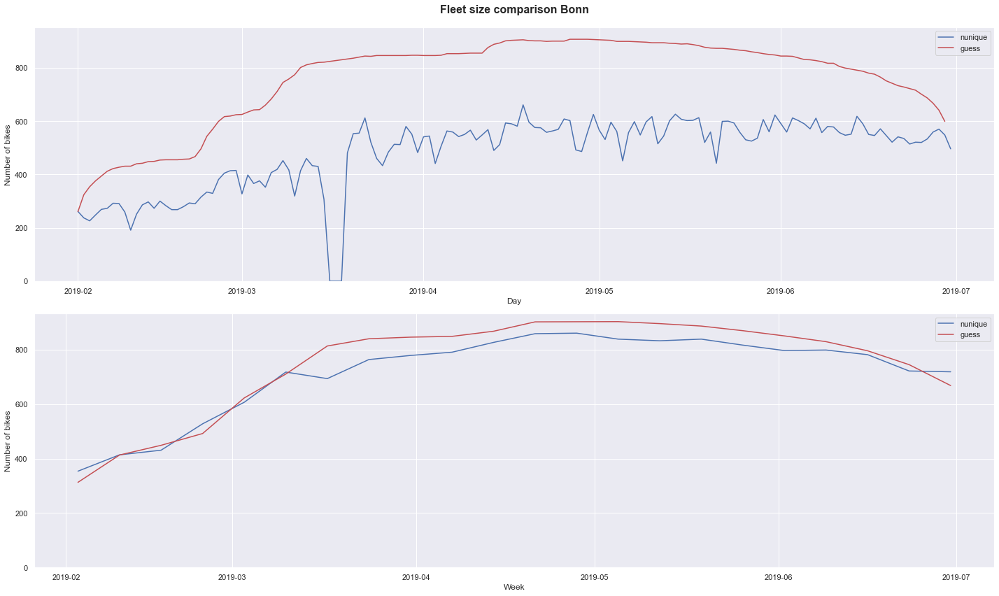

In [117]:
# Comparison of both approaches to estimate fleet size based on Bonn

fig, (ax1, ax2) = plt.subplots(2, figsize=(20,12))

ax1.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq='D'))['b_number'].nunique(), label ='nunique', color = 'C0')
ax1.plot(daily_utilization_bonn['timestamp'], daily_utilization_bonn['fleet'], label ='guess', color = 'C3')

ax1.set_title('Fleet size comparison Bonn', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Number of bikes')
ax1.set_ylim(0, )
ax1.legend()

ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq='W'))['b_number'].nunique(), label ='nunique', color = 'C0')
ax2.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['fleet'].mean(), label ='guess', color = 'C3')

ax2.set_xlabel('Week')
ax2.set_ylabel('Number of bikes')
ax2.set_ylim(0, )
ax2.legend()

fig.tight_layout()

### Comparison of daily utilization rate of both cities 

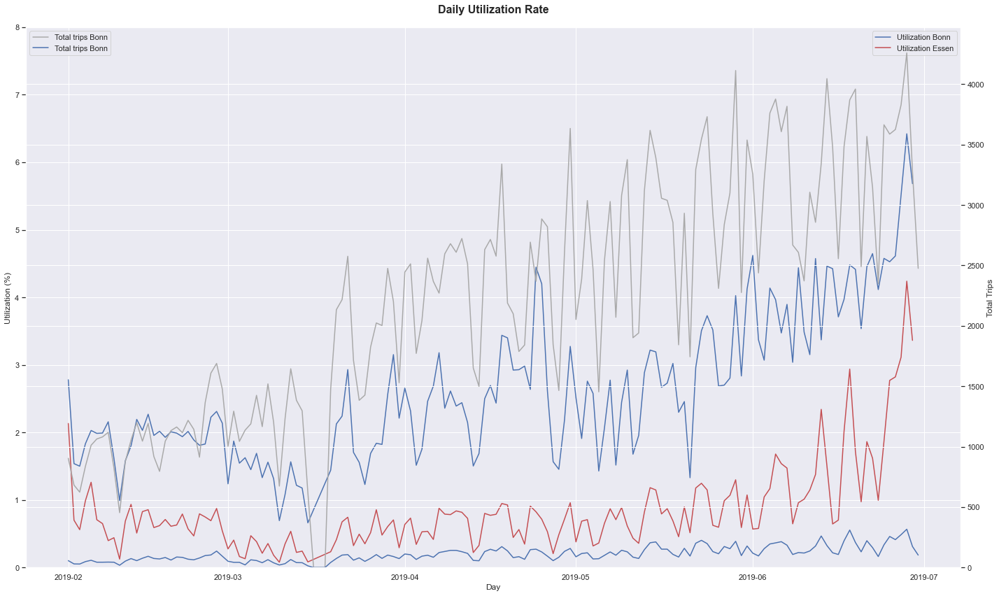

In [101]:
#daily utilization rate


fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(daily_utilization_bonn['timestamp'] ,daily_utilization_bonn['capacity_utilization_rate'], label ='Utilization Bonn', color = 'C0')
ax1.plot(daily_utilization_essen['timestamp'], daily_utilization_essen['capacity_utilization_rate'], label ='Utilization Essen', color = 'C3')


ax1.set_title('Daily Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

#adds second y axis with total trips per city

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Bonn', color = 'darkgray')
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Bonn', color = 'C0')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend()

fig.tight_layout()

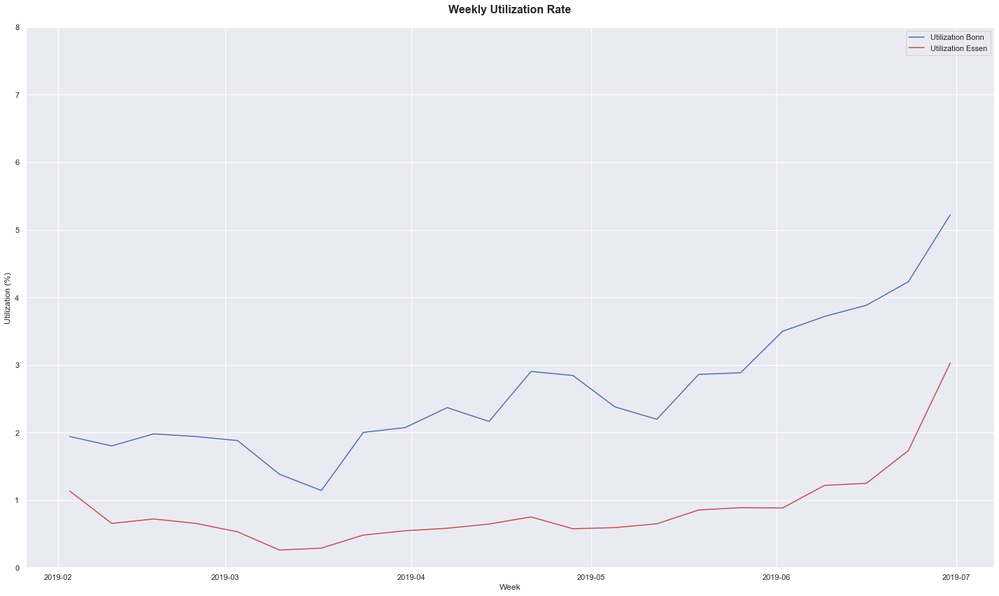

In [103]:
#weekly utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Bonn', color = 'C0')
ax1.plot( daily_utilization_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Essen', color = 'C3')

ax1.set_title('Weekly Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

#adds second y axis with total trips per city
'''
ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), color = 'darkgray', label='Total trips Bonn')
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), color = 'red', label='Total trips Bonn')
ax2.set_ylabel('Total Trips')
ax2.legend()
'''


fig.tight_layout()

#### Bonn - in Depth

(0.0, 4471.95)

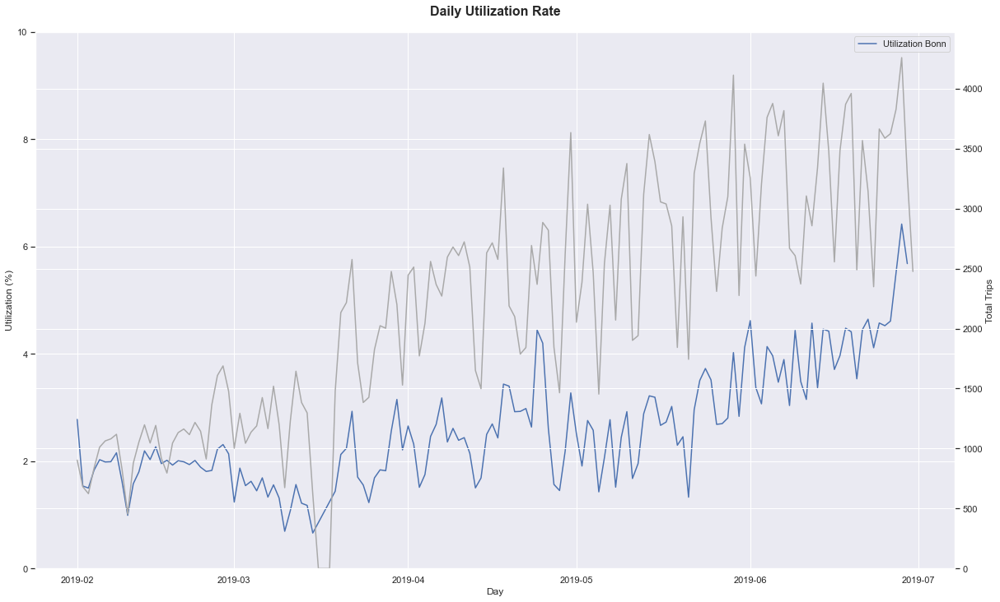

In [105]:
#daily utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(daily_utilization_bonn['timestamp'] ,daily_utilization_bonn['capacity_utilization_rate'], label ='Utilization Bonn', color = 'C0')

ax1.set_title('Daily Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,10)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), color = 'darkgray', label='Total trips Bonn')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)

fig.tight_layout()

(0.0, 25840.25)

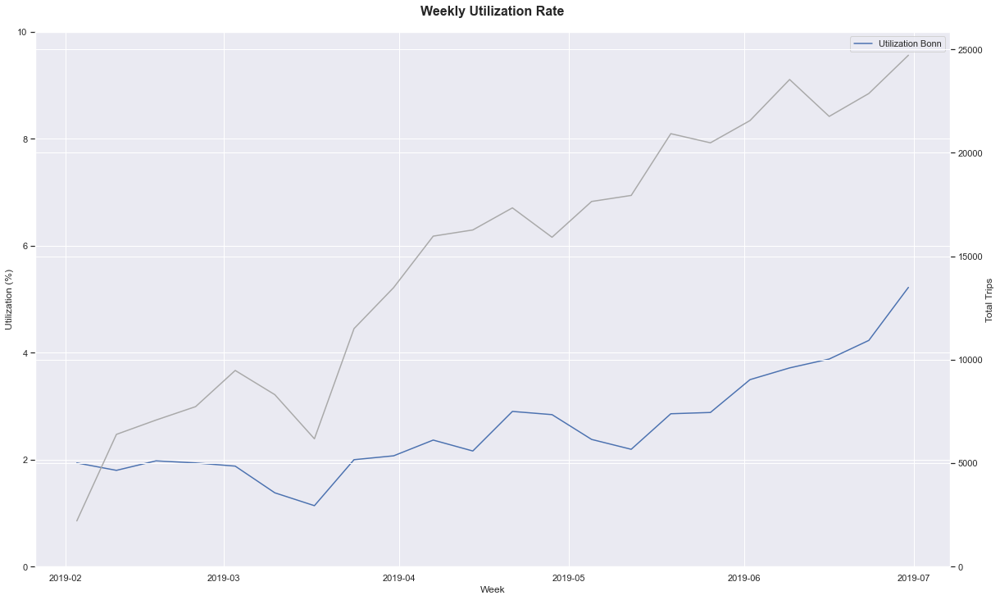

In [106]:
fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Bonn', color = 'C0')
ax1.set_title('Weekly Utilization Rate', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,10)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_bonn.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), label='Total trips Bonn', color = 'darkgray')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)

fig.tight_layout()


Text(0.5, 1.0, 'Bonn')

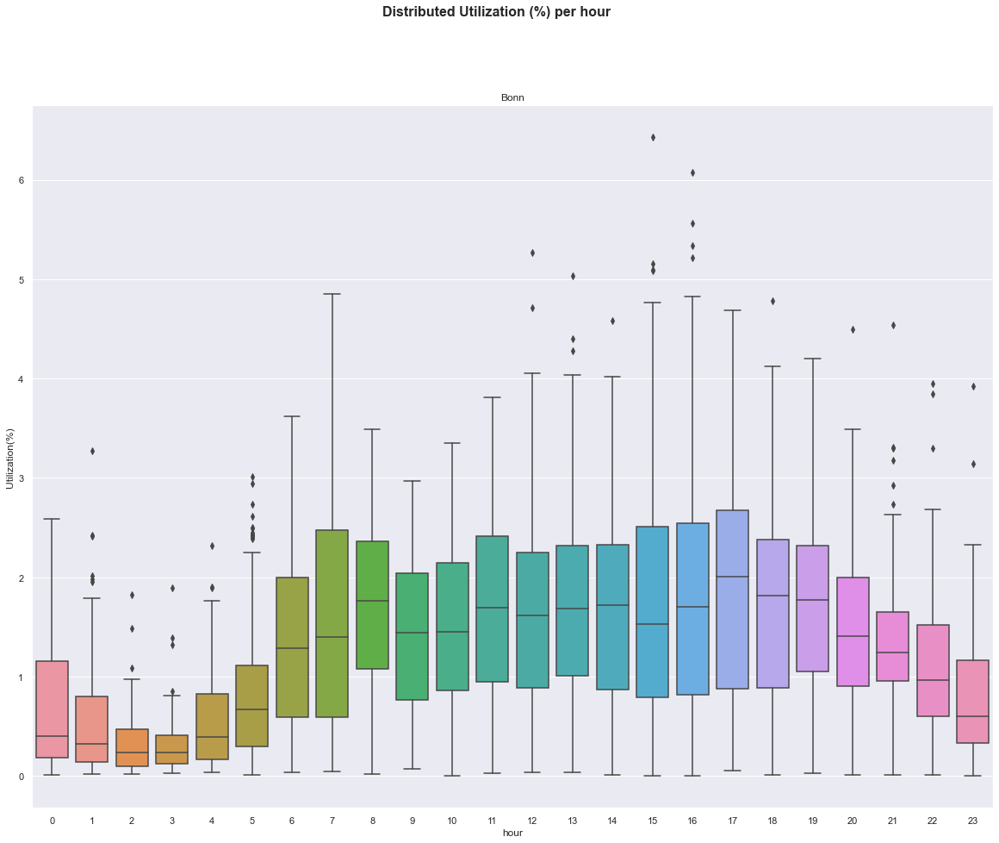

In [107]:
#mean hourly utilization in Bonn

fig, ax1 = plt.subplots(figsize=(20,15))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data=hourly_utilization_bonn)
fig.suptitle('Distributed Utilization (%) per hour', fontsize=16, fontweight="bold", va = 'center')

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Bonn')

fig.tight_layout()

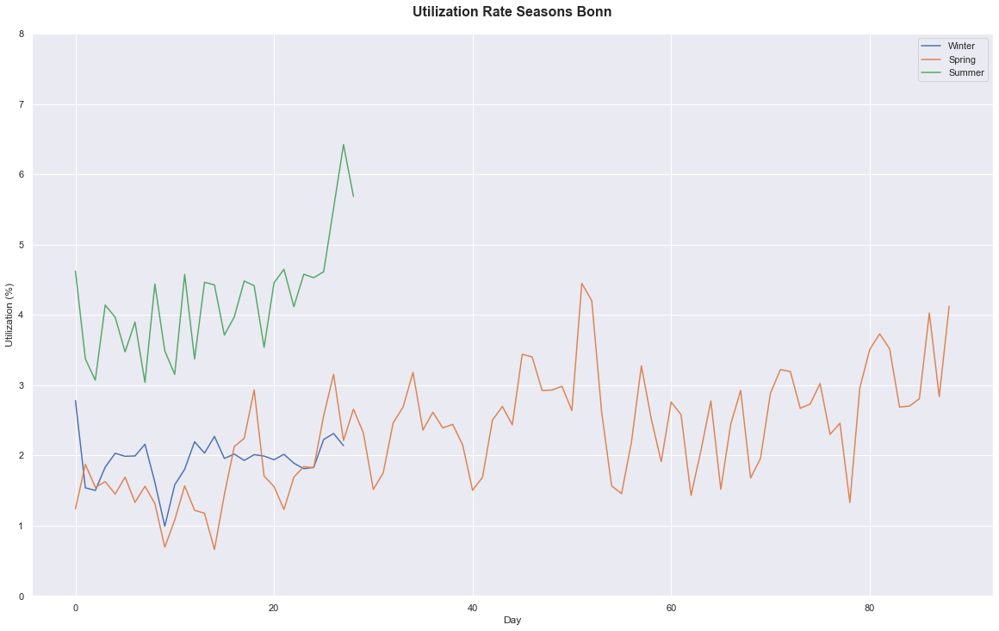

In [108]:
# Utilization rate per Season 
fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 0].reset_index()['capacity_utilization_rate'], label ='Winter')
ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 1].reset_index()['capacity_utilization_rate'], label ='Spring')
ax1.plot(daily_utilization_bonn.loc[daily_utilization_bonn['season'] == 2].reset_index()['capacity_utilization_rate'], label ='Summer')


ax1.set_title('Utilization Rate Seasons Bonn', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

fig.tight_layout()

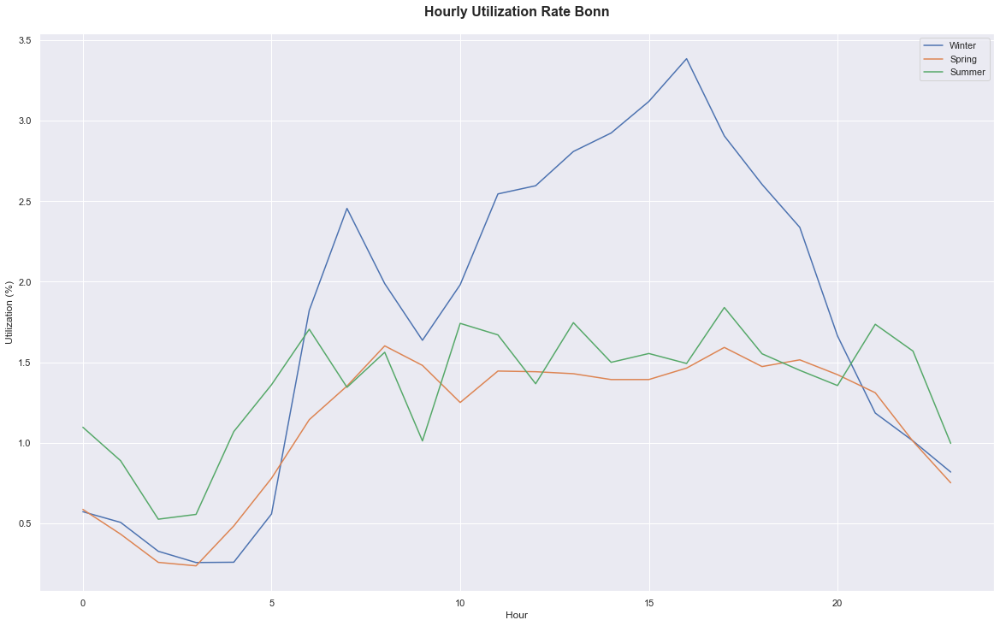

In [109]:
fig, ax1 = plt.subplots(figsize=(20,12))


ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 0].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Winter')
ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 1].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Spring')
ax1.plot(hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 2].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Summer')

ax1.set_title('Hourly Utilization Rate Bonn', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Utilization (%)')
#ax1.set_ylim(0,10)
ax1.legend()

fig.tight_layout()

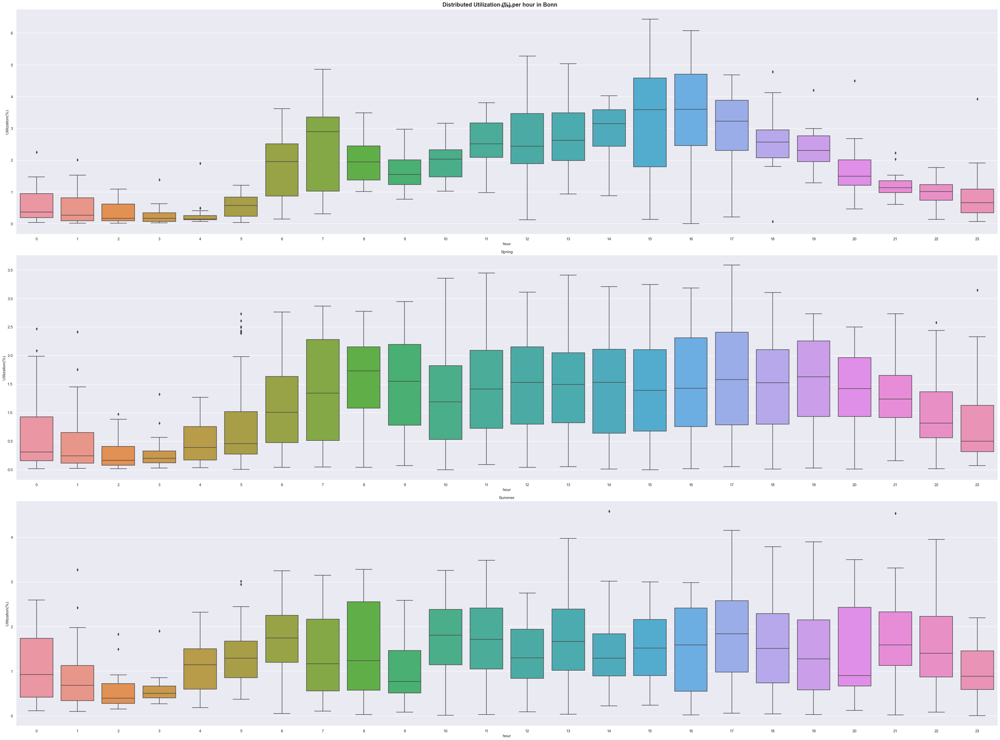

In [110]:
#mean hourly utilization in Bonn

fig, (ax1,ax2, ax3) = plt.subplots(3, figsize=(40,30))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 0])

fig.suptitle('Distributed Utilization (%) per hour in Bonn', fontsize=16, fontweight="bold", va = 'center')

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Winter')

sns.boxplot(ax = ax2, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 1])

ax2.set_xlabel('hour')
ax2.set_ylabel('Utilization(%)')
ax2.set_title('Spring')

sns.boxplot(ax = ax3, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_bonn.loc[hourly_utilization_bonn['season'] == 2])

ax3.set_xlabel('hour')
ax3.set_ylabel('Utilization(%)')
ax3.set_title('Summer')

fig.tight_layout()

#### Essen - in depth

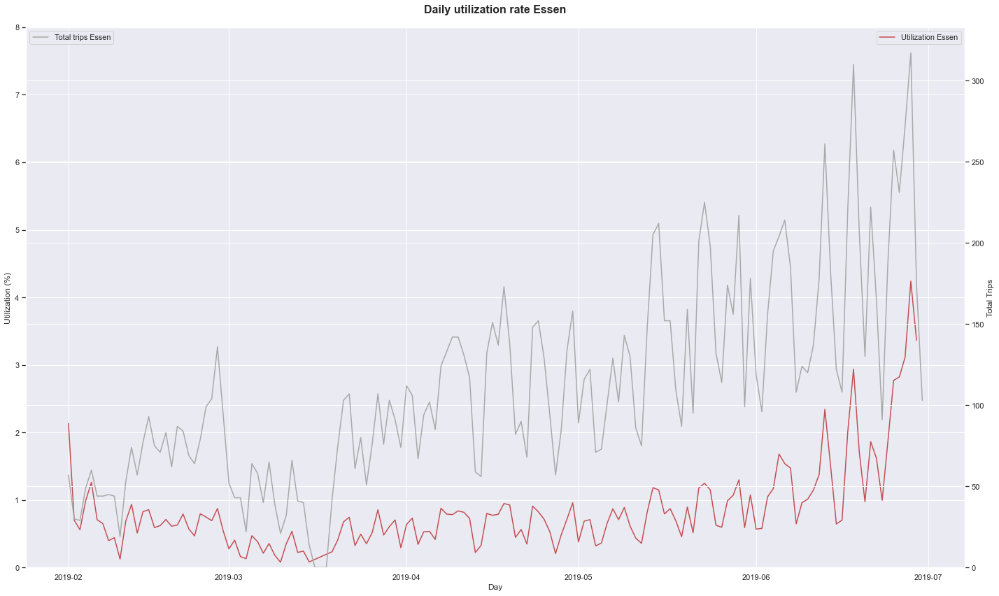

In [111]:
#daily utilization rate

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_essen['timestamp'], daily_utilization_essen['capacity_utilization_rate'], label ='Utilization Essen', color='C3')


ax1.set_title('Daily utilization rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()

ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'D'))['b_number'].count(), label='Total trips Essen', color = 'darkgray')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend(loc=2)

fig.tight_layout()

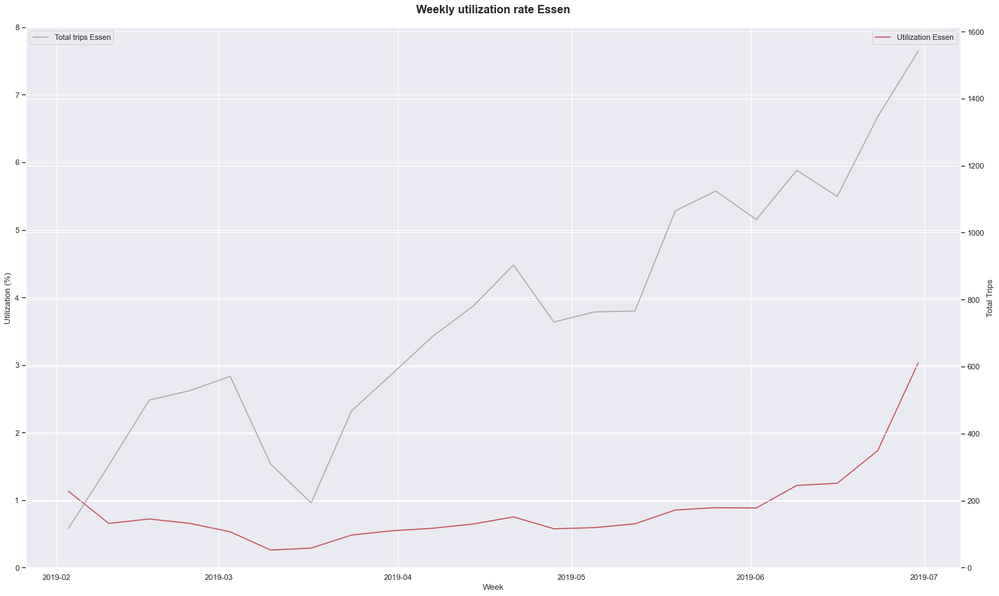

In [112]:
#weekly utilization rate Essen

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot( daily_utilization_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['capacity_utilization_rate'].mean(), label ='Utilization Essen', color='C3')

ax1.set_title('Weekly utilization rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Week')
ax1.set_ylabel('Utilization (%)')
ax1.set_ylim(0,8)
ax1.legend()


ax2 = ax1.twinx() #seconde axis sharing values with x-axis
ax2.plot(df_essen.groupby(pd.Grouper(key='timestamp', freq = 'W'))['b_number'].count(), label='Total trips Essen', color = 'darkgrey')
ax2.set_ylabel('Total Trips')
ax2.set_ylim(0,)
ax2.legend(loc=2)

fig.tight_layout()

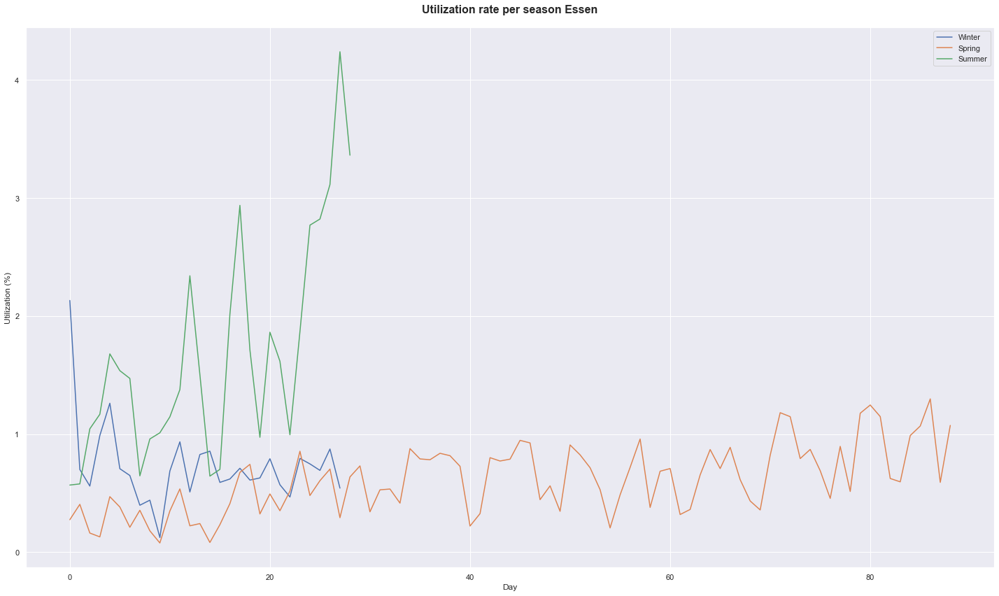

In [113]:
# Utilization rate per season in Essen

fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 0].reset_index()['capacity_utilization_rate'], label ='Winter')
ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 1].reset_index()['capacity_utilization_rate'], label ='Spring')
ax1.plot(daily_utilization_essen.loc[daily_utilization_essen['season'] == 2].reset_index()['capacity_utilization_rate'], label ='Summer')

ax1.set_title('Utilization rate per season Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Day')
ax1.set_ylabel('Utilization (%)')
ax1.legend()

fig.tight_layout()

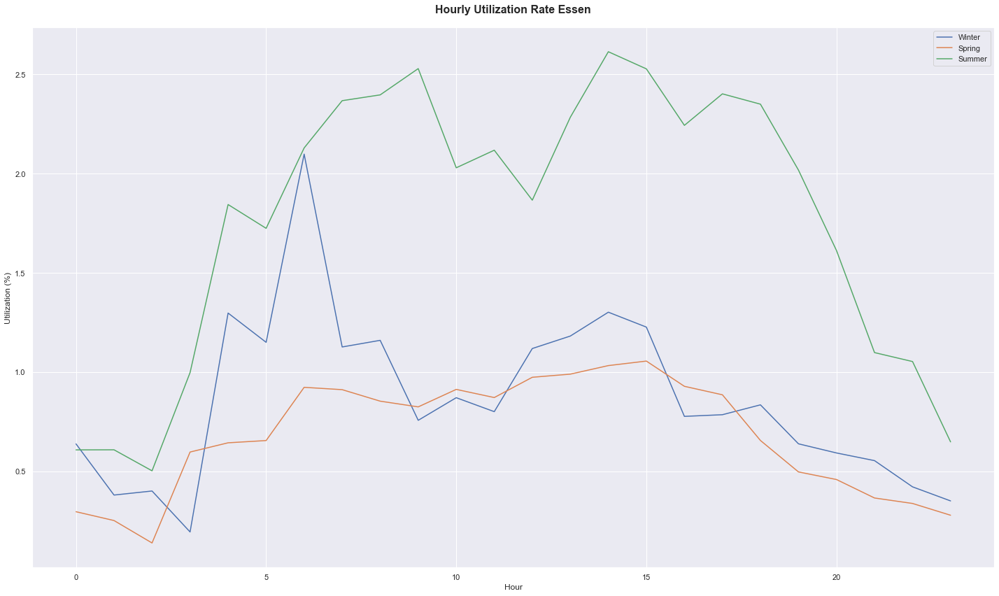

In [114]:
fig, ax1 = plt.subplots(figsize=(20,12))

ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 0].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Winter')
ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 1].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Spring')
ax1.plot(hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 2].reset_index().groupby('hour')['capacity_utilization_rate'].mean(), label ='Summer')

ax1.set_title('Hourly Utilization Rate Essen', fontsize=16, fontweight="bold", pad=20)
ax1.set_xlabel('Hour')
ax1.set_ylabel('Utilization (%)')
ax1.legend()

fig.tight_layout()

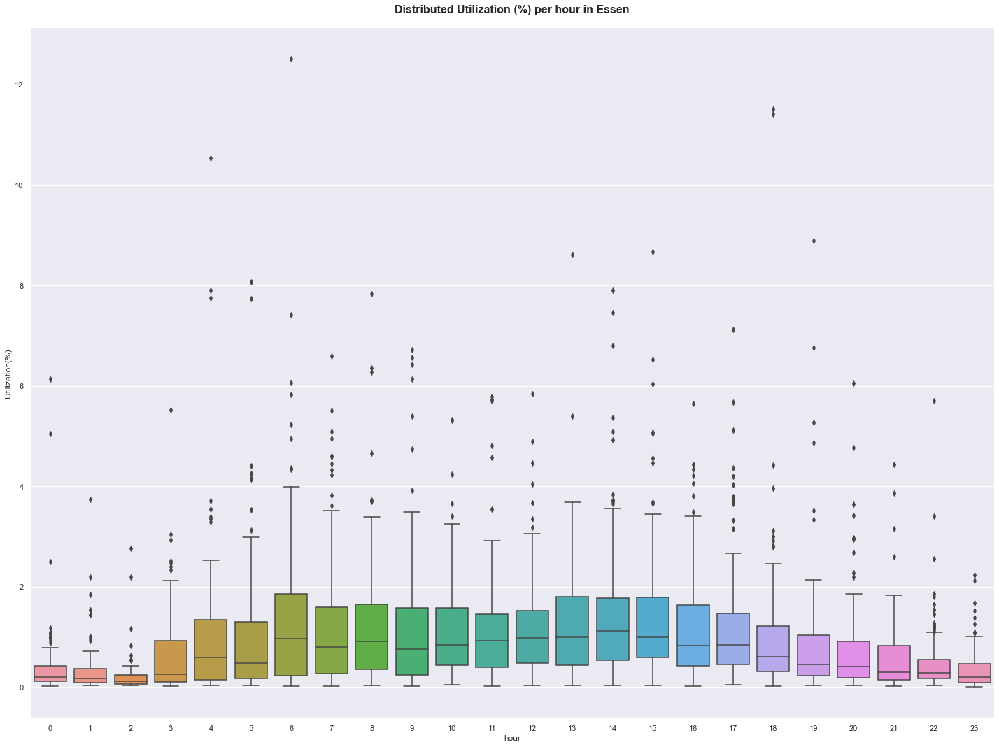

In [115]:
#mean hourly utilization in Essen

fig, ax1 = plt.subplots(figsize=(20,15))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data=hourly_utilization_essen)
sns.light_palette("Seagreen")

ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Distributed Utilization (%) per hour in Essen', fontsize=16, fontweight="bold", pad=20)

fig.tight_layout()


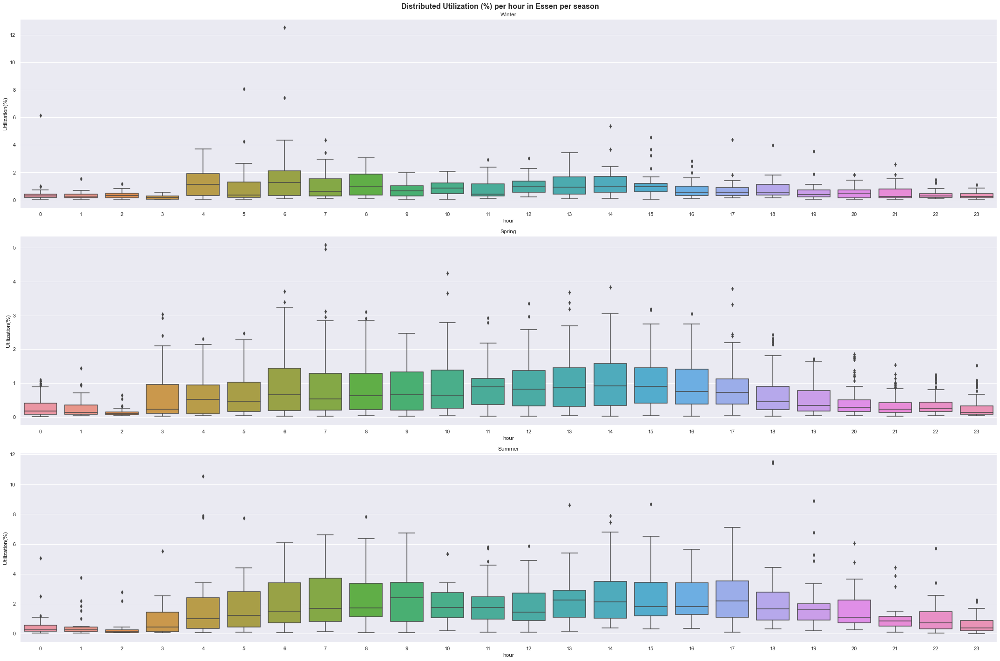

In [116]:
#mean hourly utilization in Bonn

fig, (ax1,ax2, ax3) = plt.subplots(3, figsize=(30,20))

sns.boxplot(ax = ax1, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 0])
fig.suptitle('Distributed Utilization (%) per hour in Essen per season', fontsize=16, fontweight="bold", va = 'center')


ax1.set_xlabel('hour')
ax1.set_ylabel('Utilization(%)')
ax1.set_title('Winter')

sns.boxplot(ax = ax2, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 1])


ax2.set_xlabel('hour')
ax2.set_ylabel('Utilization(%)')
ax2.set_title('Spring')

sns.boxplot(ax = ax3, x="hour", y="capacity_utilization_rate",
                    data= hourly_utilization_essen.loc[hourly_utilization_essen['season'] == 2])

ax3.set_xlabel('hour')
ax3.set_ylabel('Utilization(%)')
ax3.set_title('Summer')

fig.tight_layout()

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from datetime import datetime, timedelta, date, time
import ssl
import urllib
import json
from haversine import haversine, Unit
import folium
from folium import plugins
from folium.plugins import HeatMap
import seaborn as sns

In [10]:
#pickle down below
# Prepare the data

# Sort the entries by b_number and timestamp (Bonn)
'''df_bonn_idle = df_bonn.sort_values(["b_number", "timestamp"])
df_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)

df_bonn_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)

for i in range(df_bonn_idle.shape[0] - 1):
    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:
        df_bonn_idle["idle_time"][i+1] = df_bonn_idle["timestamp"][i+1] - (df_bonn_idle["timestamp"][i] + df_bonn_idle["trip_duration"][i])
    else:
        df_bonn_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)



# Removing trips which have no idle time because they are the first trip of this bike in the examined time period
df_bonn_no_idle = df_bonn_idle[df_bonn_idle["idle_time"] < timedelta(minutes=1)]
df_bonn_idle = df_bonn_idle[~df_bonn_idle.isin(df_bonn_no_idle).all(1)]

df_bonn_idle["idle_time_minutes"] = (df_bonn_idle["idle_time"].dt.days * 1440) + (df_bonn_idle["idle_time"].dt.seconds / 60)'''

In [11]:
'''df_essen_idle = df_essen.sort_values(["b_number", "timestamp"])
df_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)

df_essen_idle["idle_time"] = timedelta(days=0, hours=0, minutes=0, seconds=0)

for i in range(df_essen_idle.shape[0] - 1):
    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:
        df_essen_idle["idle_time"][i+1] = df_essen_idle["timestamp"][i+1] - (df_essen_idle["timestamp"][i] + df_essen_idle["trip_duration"][i])
    else:
        df_essen_idle["idle_time"][i+1] = timedelta(days=0, hours=0, minutes=0, seconds=0)

# Removing trips which have no idle time because they are the first trip of this bike in the examined time period
df_essen_no_idle = df_essen_idle[df_essen_idle["idle_time"] < timedelta(minutes=1)]
df_essen_idle = df_essen_idle[~df_essen_idle.isin(df_essen_no_idle).all(1)]

df_essen_idle["idle_time_minutes"] = (df_essen_idle["idle_time"].dt.days * 1440) + (df_essen_idle["idle_time"].dt.seconds / 60)'''

In [12]:
df_bonn_idle.head()

,day,time,b_number,city,trip_duration,timestamp,weekday,hour,season,orig,dest,idle_time,idle_time_minutes
2,2019-02-01,13:34:00,44500,bonn,0 days 00:24:00,2019-02-01 13:34:00,4,13,0,"[50.7066, 7.1102]","[50.7064, 7.1099]",0 days 00:39:00,39.0
3,2019-02-01,16:08:00,44500,bonn,0 days 00:07:00,2019-02-01 16:08:00,4,16,0,"[50.7065, 7.1099]","[50.7074, 7.1232]",0 days 02:10:00,130.0
4,2019-02-01,16:59:00,44500,bonn,0 days 00:08:00,2019-02-01 16:59:00,4,16,0,"[50.7074, 7.1232]","[50.7061, 7.1121]",0 days 00:44:00,44.0
5,2019-02-03,11:01:00,44500,bonn,0 days 00:07:00,2019-02-03 11:01:00,6,11,0,"[50.7062, 7.112]","[50.7071, 7.1236]",1 days 17:54:00,2514.0
6,2019-02-03,12:28:00,44500,bonn,0 days 00:07:00,2019-02-03 12:28:00,6,12,0,"[50.7071, 7.1235]","[50.7056, 7.1109]",0 days 01:20:00,80.0


In [19]:
'''df_bonn_idle = df_bonn_idle.sort_values(["b_number", "timestamp"])
df_bonn_idle = df_bonn_idle.reset_index().drop(["index"], axis=1)

df_bonn_idle["distance_switched_position"] = 0 
df_bonn_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)
df_bonn_idle['Last_ride_dest'] = df_bonn['dest']

for i in range(df_bonn_idle.shape[0] - 1):
    if df_bonn_idle["b_number"][i] == df_bonn_idle["b_number"][i+1]:
        if df_bonn_idle["dest"][i][0] == df_bonn_idle["orig"][i+1][0] and df_bonn_idle["dest"][i][1] == df_bonn_idle["orig"][i+1][1]: 
            df_bonn_idle["distance_switched_position"][i+1] = 0
            df_bonn_idle['Last_ride_dest'][i+1] = 0
        else:
            df_bonn_idle["distance_switched_position"][i+1] = haversine(df_bonn_idle["dest"][i], df_bonn_idle["orig"][i+1], unit=Unit.METERS)
            df_bonn_idle["Last_ride"][i+1] = df_bonn_idle['idle_time'][i]
            df_bonn_idle['Last_ride_dest'][i+1] = df_bonn_idle['dest'][i]
    else:
        df_bonn_idle["distance_switched_position"][i+1] = 0
        df_bonn_idle['Last_ride_dest'][i+1] = 0'''

In [13]:
'''df_essen_idle = df_essen_idle.sort_values(["b_number", "timestamp"])
df_essen_idle = df_essen_idle.reset_index().drop(["index"], axis=1)

df_essen_idle["distance_switched_position"] = 0 
df_essen_idle["Last_ride"] = timedelta(days=0, hours=0, minutes=0, seconds=0)
df_essen_idle['Last_ride_dest'] = df_essen['dest']

for i in range(df_essen_idle.shape[0] - 1):
    if df_essen_idle["b_number"][i] == df_essen_idle["b_number"][i+1]:
        if df_essen_idle["dest"][i][0] == df_essen_idle["orig"][i+1][0] and df_essen_idle["dest"][i][1] == df_essen_idle["orig"][i+1][1]: 
            df_essen_idle["distance_switched_position"][i+1] = 0
            df_essen_idle['Last_ride_dest'][i+1] = 0
        else:
            df_essen_idle["distance_switched_position"][i+1] = haversine(df_essen_idle["dest"][i], df_essen_idle["orig"][i+1], unit=Unit.METERS)
            df_essen_idle["Last_ride"][i+1] = df_essen_idle['idle_time'][i]
            df_essen_idle['Last_ride_dest'][i+1] = df_essen_idle['dest'][i]
    else:
        df_essen_idle["distance_switched_position"][i+1] = 0
        df_essen_idle['Last_ride_dest'][i+1] = 0'''

In [20]:
df_bonn_idle.head()

,day,time,b_number,city,trip_duration,timestamp,weekday,hour,season,orig,dest,idle_time,idle_time_minutes,distance (km),distance_city_center,distance_switched_position,Last_ride,Last_ride_dest
0,2019-02-01,13:34:00,44500,bonn,0 days 00:24:00,2019-02-01 13:34:00,4,13,0,"[50.7066, 7.1102]","[50.7064, 7.1099]",0 days 00:39:00,39.0,0.485359,0.345910,0,0 days 00:00:00,"[50.739, 7.093]"
1,2019-02-01,16:08:00,44500,bonn,0 days 00:07:00,2019-02-01 16:08:00,4,16,0,"[50.7065, 7.1099]","[50.7074, 7.1232]",0 days 02:10:00,130.0,1.079285,2.580732,11,0 days 00:39:00,"[50.7064, 7.1099]"
2,2019-02-01,16:59:00,44500,bonn,0 days 00:08:00,2019-02-01 16:59:00,4,16,0,"[50.7074, 7.1232]","[50.7061, 7.1121]",0 days 00:44:00,44.0,2.012538,2.447123,0,0 days 00:00:00,0
3,2019-02-03,11:01:00,44500,bonn,0 days 00:07:00,2019-02-03 11:01:00,6,11,0,"[50.7062, 7.112]","[50.7071, 7.1236]",1 days 17:54:00,2514.0,2.218251,2.348133,13,0 days 00:44:00,"[50.7061, 7.1121]"
4,2019-02-03,12:28:00,44500,bonn,0 days 00:07:00,2019-02-03 12:28:00,6,12,0,"[50.7071, 7.1235]","[50.7056, 7.1109]",0 days 01:20:00,80.0,0.030670,2.731179,7,1 days 17:54:00,"[50.7071, 7.1236]"


In [15]:
'''#distance between start and end point

df_bonn_idle["distance (km)"] = df_bonn.apply(lambda row: haversine(row["orig"], row["dest"]), axis=1)
df_essen_idle["distance (km)"] = df_essen.apply(lambda row: haversine(row["orig"], row["dest"]), axis=1)

#distance between city center and end point

df_bonn_idle["distance_city_center"] = df_bonn.apply(lambda row: haversine(bonn_center, row["dest"]), axis=1)
df_essen_idle["distance_city_center"] = df_essen.apply(lambda row: haversine(essen_center, row["dest"]), axis=1)'''

In [21]:
'''df_bonn_idle.to_pickle("data/df_bonn_idle.pickle")
df_essen_idle.to_pickle("data/df_essen_idle.pickle")'''

In [22]:
df_bonn_idle = pd.read_pickle("data/df_bonn_idle.pickle")
df_essen_idle = pd.read_pickle("data/df_essen_idle.pickle")

In [18]:
df_essen_idle.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15915 entries, 0 to 15914
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   day                         15915 non-null  object         
 1   time                        15915 non-null  object         
 2   b_number                    15915 non-null  int64          
 3   city                        15915 non-null  object         
 4   trip_duration               15915 non-null  timedelta64[ns]
 5   timestamp                   15915 non-null  datetime64[ns] 
 6   weekday                     15915 non-null  int64          
 7   hour                        15915 non-null  int64          
 8   season                      15915 non-null  int64          
 9   orig                        15915 non-null  object         
 10  dest                        15915 non-null  object         
 11  idle_time                   15915 non-nul

In [30]:
df_bonn_intervention = df_bonn_idle.loc[df_bonn_idle['distance_switched_position']> 99].reset_index()
df_essen_intervention = df_essen_idle.loc[df_essen_idle['distance_switched_position']> 99].reset_index()
 

In [24]:
# definition of a intervention of nextbike
# interveniton = human interaction = labor costs
# Intervention 1 = bike trip start in a diffrent position than the last trip ended 
# Intervention 2 = idle time > X Minutes 

In [35]:
# show position changes 
def interventions_zone_map(location, df_interventions):
        #First draw a map like zone_map() does
         # Generate a map - centered on the given location
        if (location == bonn_center).all():
            location = location-np.array([-0.1, 0.3]) # shift by [-0.1, 0.3] to make it look better (more centered)
        elif (location == essen_center).all():
            location = location-np.array([0, 0]) # shift by [0.1, 0] to make it look better (more centered)

        interventions_zone_map = folium.Map(
            location = location,
            tiles = "OpenStreetMap",
            zoom_start = 10)
    
        # Now outliers have to be added to the map
        # The outliers are stored in df_outliers
        for index, row in df_interventions.iterrows():
            
            # Save startpoint and endpoint
            startpoint = tuple(row["Last_ride_dest"])
            #endpoint = tuple(row["orig"])
            
            # Draw the lines between startpoints and endpoints
            #folium.PolyLine(
            #locations = [startpoint, endpoint],
            #color = "purple",
            #weight = 2,
            #opacity = 0.5
            #).add_to(interventions_zone_map)
            
            #Draw Cricles for startpoints and endpoints
            #Green circles = startpoints
            folium.CircleMarker(
            location = startpoint,
            radius = 4,
            color = "green").add_to(interventions_zone_map)
            # Red circles = endpoints
            #folium.CircleMarker(
            #location = endpoint,
            #radius = 4,
            #color = "crimson").add_to(interventions_zone_map) 
        
        return interventions_zone_map

In [36]:
interventions_zone_map(bonn_center, df_bonn_intervention)

In [37]:
interventions_zone_map(essen_center, df_essen_intervention)

In [38]:
#Interventions in diffrent times overall

total_interventions= pd.DataFrame(data = {'city': ['Bonn', 'Essen' ], 'total': [df_bonn_intervention['timestamp'].count(), df_essen_intervention['timestamp'].count()], 'per_1000_trips': [(df_bonn_intervention['timestamp'].count()/df_bonn['timestamp'].count()) * 1000,(df_essen_intervention['timestamp'].count()/df_essen['timestamp'].count()) * 1000]})

total_interventions.head()




,city,total,per_1000_trips
0,Bonn,23952,72.733456
1,Essen,3515,211.581292


In [39]:
df_essen['timestamp'].count()

16613

Text(0, 0.5, 'Total Interventions')

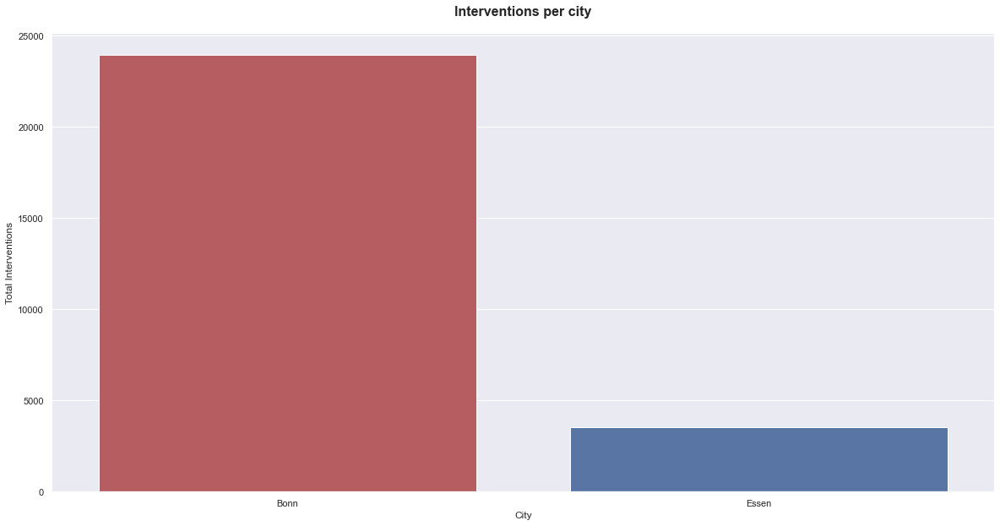

In [40]:
#compare total Interventions per City

#prepare data

fig, ax = plt.subplots(figsize=(20,10))

clrs = ['C3', 'C0' ]

ax = sns.barplot(x = 'city', y = 'total', data = total_interventions, palette= clrs)

ax.set_title('Interventions per city', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('City')
ax.set_ylabel('Total Interventions')


Text(0, 0.5, 'Interventions per 1000 trips')

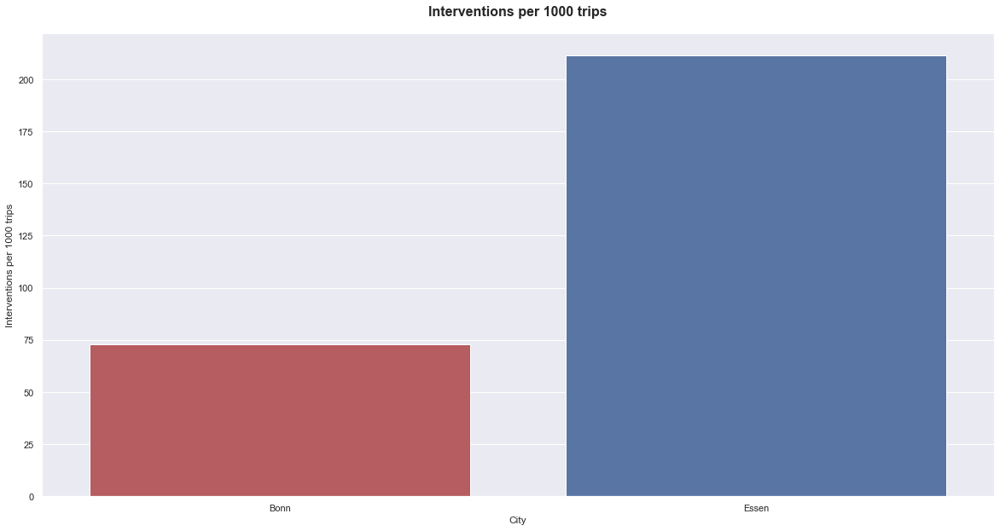

In [43]:
# compare Interventions per trip per 1000 trips

fig, ax = plt.subplots(figsize=(20,10))

clrs = ['C3', 'C0']

ax = sns.barplot(x = 'city', y = 'per_1000_trips', data = total_interventions, palette= clrs)

ax.set_title('Interventions per 1000 trips', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('City')
ax.set_ylabel('Interventions per 1000 trips')

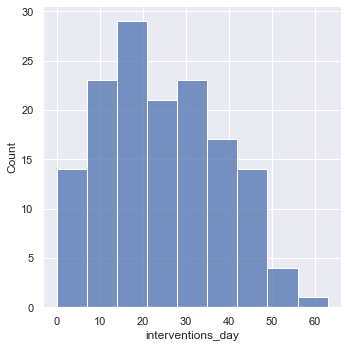

In [69]:
#Interventions per day in Essen



#fig, ax = plt.subplots(figsize=(20,10))

sns.displot(df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='interventions_day', color = "C0")

#ax.set_title('Interventions per city per 1000 trips', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('City')
#ax.set_ylabel('INterventions per 1000 trips')


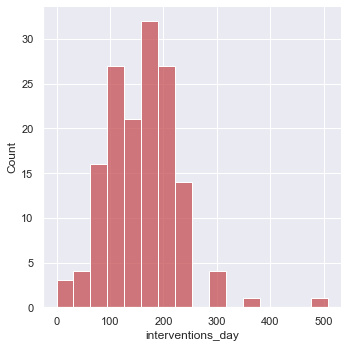

In [44]:
#Interventions per day in Bonn


sns.displot(df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='interventions_day', color = "C3")


(0.0, 66.15)

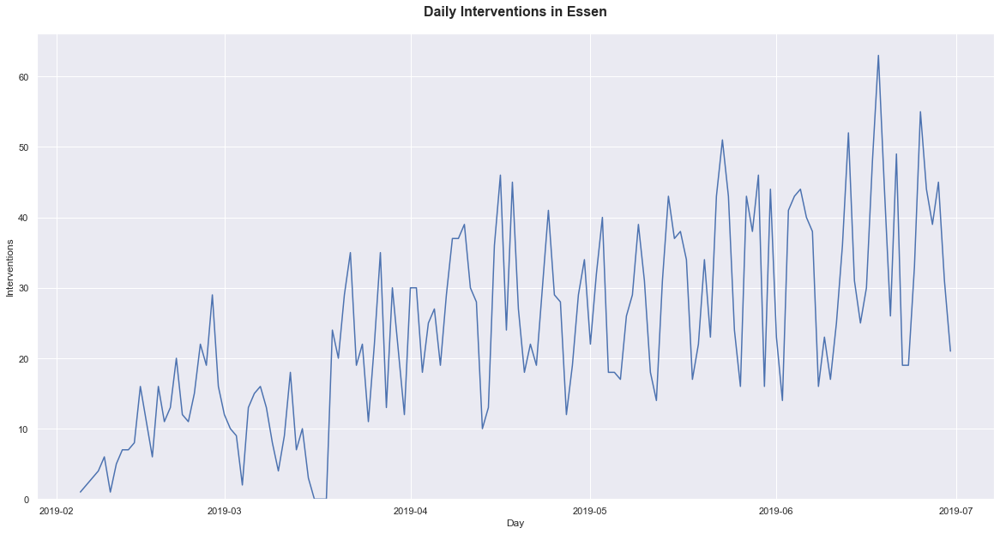

In [81]:
#daily interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C0")

ax.set_title('Daily Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 532.35)

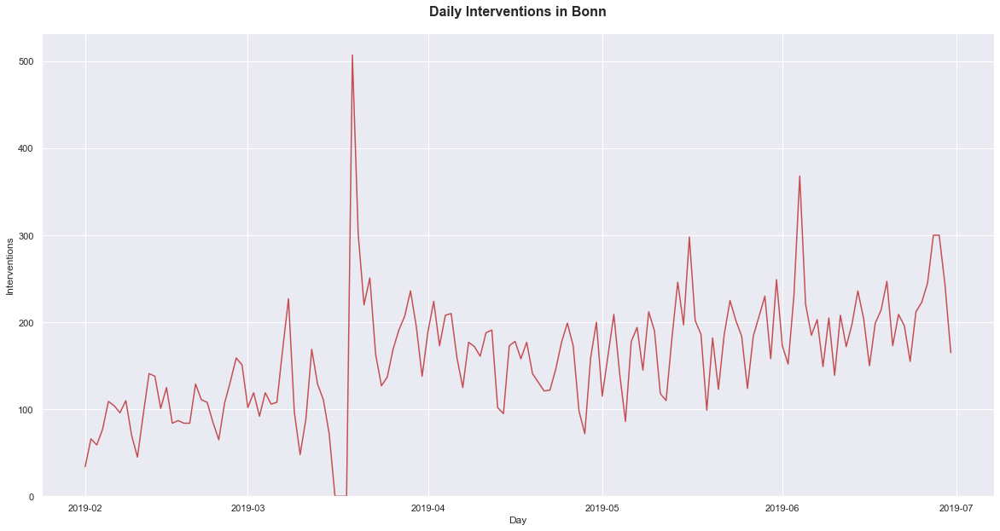

In [45]:
#daily interventionsin Bonn 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C3")

ax.set_title('Daily Interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

Text(0, 0.5, 'Interventions')

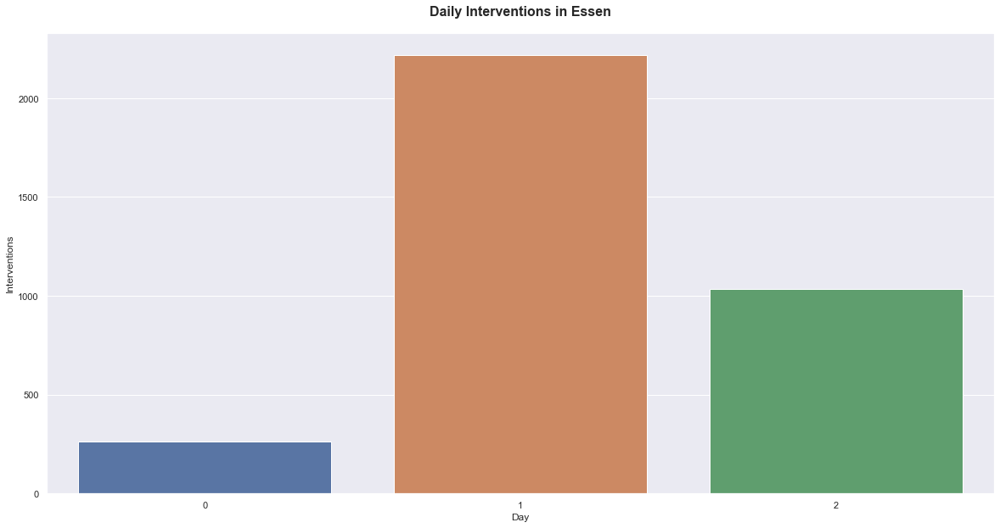

In [65]:
#daily interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

'''ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 0]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1) , label = 'Winter', color='C0')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 1]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1), label = 'Spring', color='C1')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 2]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'D'))['day'].count().reset_index(name= 'interventions_day').drop('timestamp', axis=1), label = 'Summer', color='C2')'''
ax = sns.barplot(data = df_essen_intervention.groupby(['day', 'season'])['time'].count().reset_index().drop('day', axis =1).groupby('season')['time'].sum().reset_index(name='total_interventions'), x= 'season', y='total_interventions')


ax.set_title('Daily Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Day')
ax.set_ylabel('Interventions')


In [58]:
df_essen_intervention.groupby(['day', 'season'])['time'].count().reset_index().drop('day', axis =1)

,season,time
0,0,1
1,0,2
2,0,3
3,0,4
4,0,6
...,...,...
138,2,44
139,2,39
140,2,45
141,2,31


(0.0, 280.55)

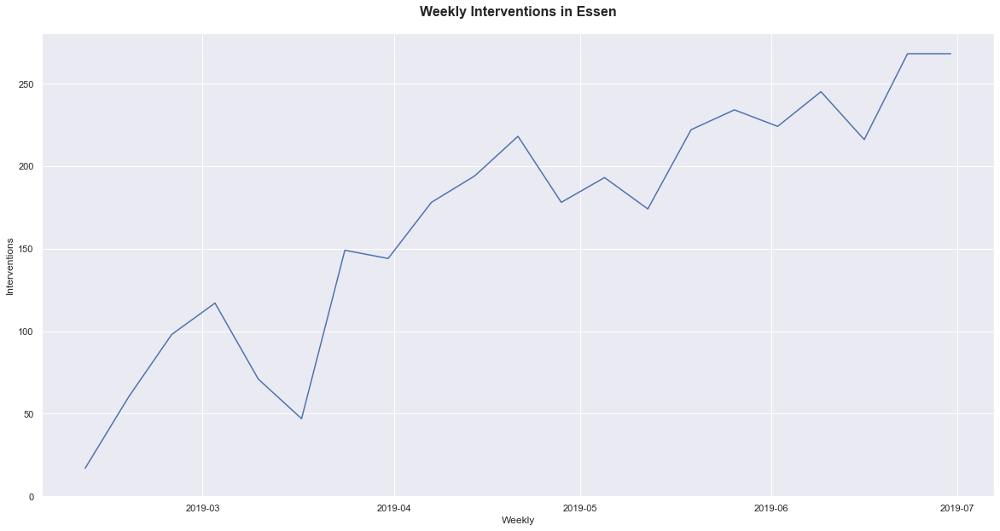

In [80]:
#weekly interventionsin essen 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_essen_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C0")

ax.set_title('Weekly Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 1764.45)

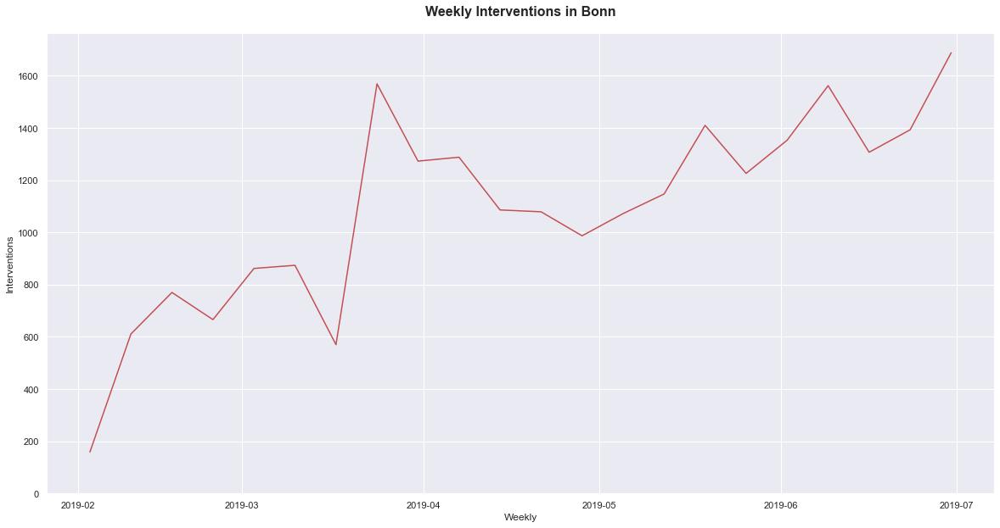

In [47]:
#weekly interventionsin bonn 
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = df_bonn_intervention.groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), x='timestamp', y= 'interventions_day',   color = "C3")

ax.set_title('Weekly Interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

(0.0, 0.05500000000000001)

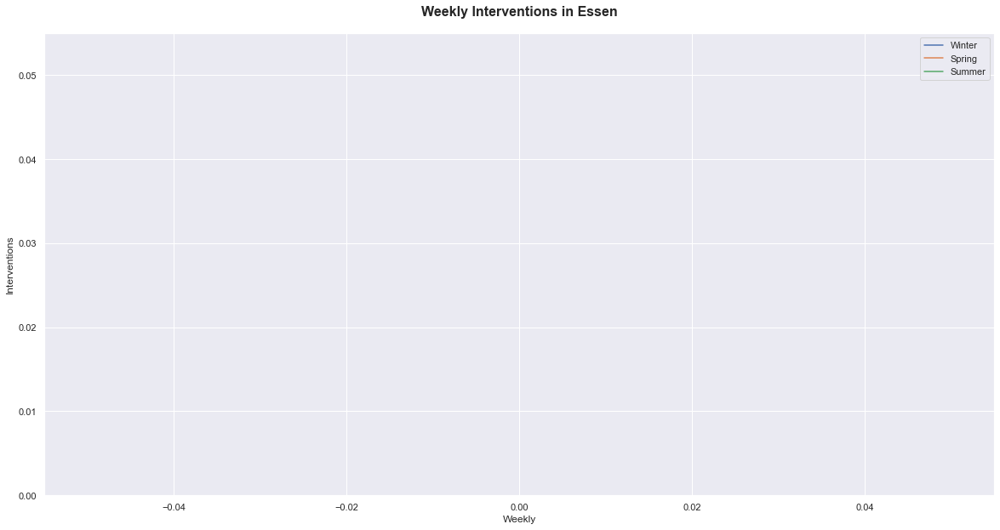

In [141]:
#weekly interventionsin essen per season
fig, ax = plt.subplots(figsize=(20,10))

ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 0]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'), y= 'interventions_day', label = 'Winter')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 1]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'),  y= 'interventions_day', label = 'Spring')
ax = sns.lineplot(data = pd.DataFrame(df_essen_intervention.loc[df_essen_intervention['season'] == 2]).reset_index().groupby(pd.Grouper(key = 'timestamp', freq= 'W'))['day'].count().reset_index(name= 'interventions_day'),  y= 'interventions_day', label = 'Summer')

ax.set_title('Weekly Interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Weekly')
ax.set_ylabel('Interventions')
ax.set_ylim(0,)

Text(0, 0.5, 'Interventions (mean)')

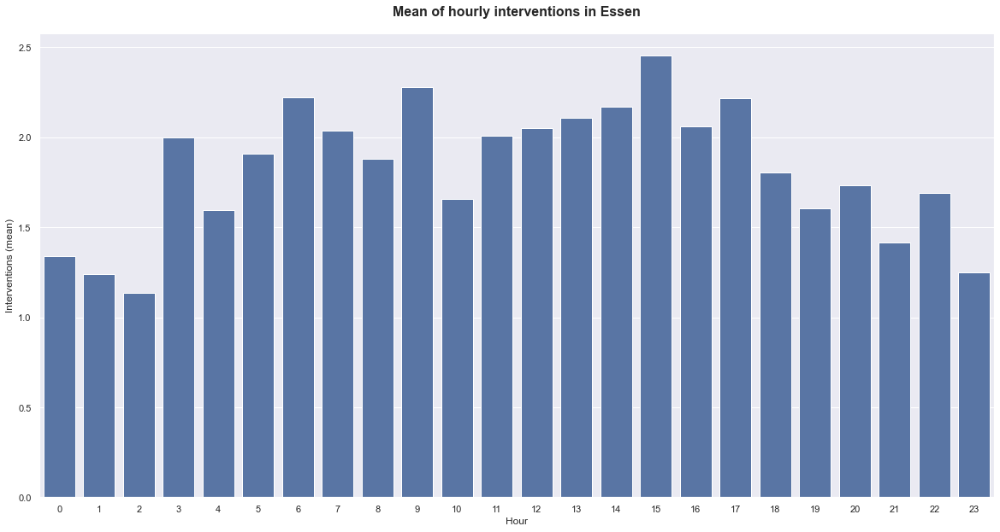

In [102]:

fig, ax = plt.subplots(figsize=(20,10))


ax = sns.barplot(x = 'hour', y = 'hourly_mean', data = df_essen_intervention.groupby(['day', 'hour'])['time'].count().reset_index().groupby('hour')['time'].mean().reset_index(name='hourly_mean'), color = 'C0')

ax.set_title('Mean of hourly interventions in Essen', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Hour')
ax.set_ylabel('Interventions (mean)')

Text(0, 0.5, 'Interventions (mean)')

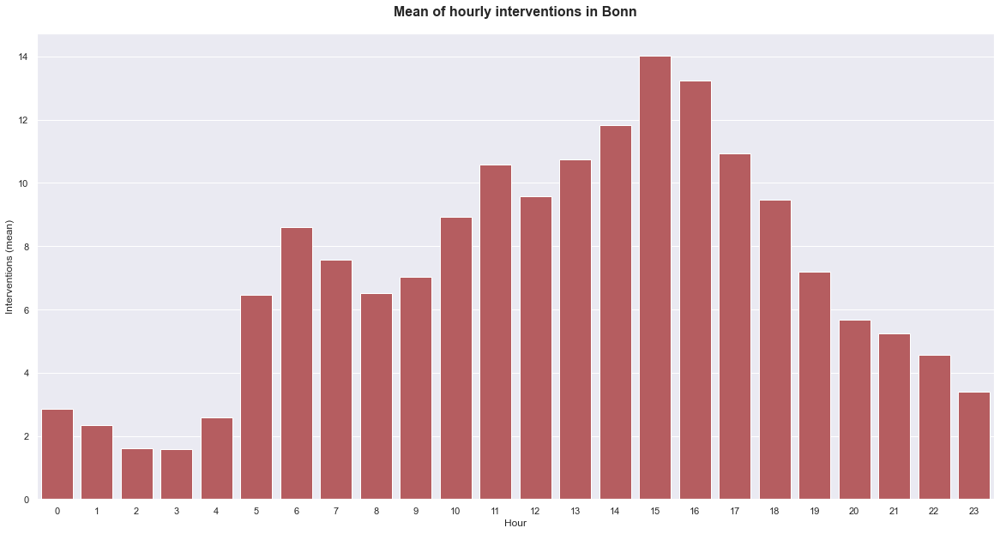

In [49]:
fig, ax = plt.subplots(figsize=(20,10))


ax = sns.barplot(x = 'hour', y = 'hourly_mean', data = df_bonn_intervention.groupby(['day', 'hour'])['time'].count().reset_index().groupby('hour')['time'].mean().reset_index(name='hourly_mean'), color = 'C3')

ax.set_title('Mean of hourly interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
ax.set_xlabel('Hour')
ax.set_ylabel('Interventions (mean)')

Text(0.5, 0.98, 'Mean of hourly interventions per Season')

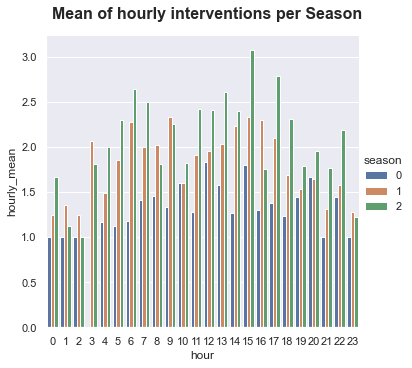

In [123]:
#fig, ax = plt.subplots(figsize=(20,10))

ax = sns.catplot(x = 'hour', y = 'hourly_mean', hue= 'season', data = df_essen_intervention.groupby(['season', 'day', 'hour'])['time'].count().reset_index().groupby(['season','hour'])['time'].mean().reset_index(name='hourly_mean'), kind="bar")

ax.fig.subplots_adjust(top=0.9)
ax.fig.suptitle('Mean of hourly interventions per Season', fontsize=16, fontweight="bold")


#ax.set_title('Mean of hourly interventions in Essen', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('Hour')
#ax.set_ylabel('Interventions (mean)')

Text(0.5, 0.98, 'Mean of hourly interventions per Season')

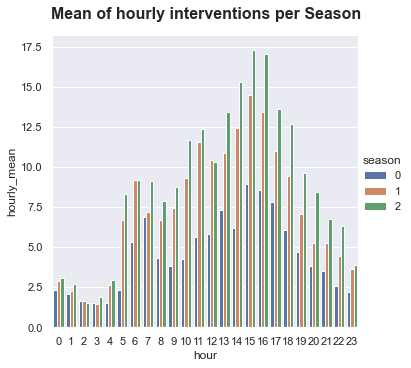

In [50]:
#fig, ax = plt.subplots(figsize=(20,10))

ax = sns.catplot(x = 'hour', y = 'hourly_mean', hue= 'season', data = df_bonn_intervention.groupby(['season', 'day', 'hour'])['time'].count().reset_index().groupby(['season','hour'])['time'].mean().reset_index(name='hourly_mean'), kind="bar")

ax.fig.subplots_adjust(top=0.9)
ax.fig.suptitle('Mean of hourly interventions per Season', fontsize=16, fontweight="bold")


#ax.set_title('Mean of hourly interventions in Bonn', fontsize=16, fontweight="bold", pad=20)
#ax.set_xlabel('Hour')
#ax.set_ylabel('Interventions (mean)')

In [20]:
'''#idle time + rate
daily_utilization_bonn['idle_time']  = df_bonn_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']
daily_utilization_bonn['idle_time'] = (daily_utilization_bonn['idle_time'].dt.days * 1440) + (daily_utilization_bonn['idle_time'].dt.seconds / 60)
daily_utilization_bonn['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_bonn['idle_time'] / daily_utilization_bonn['max_capacity'])'''

"#idle time + rate\ndaily_utilization_bonn['idle_time']  = df_bonn_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']\ndaily_utilization_bonn['idle_time'] = (daily_utilization_bonn['idle_time'].dt.days * 1440) + (daily_utilization_bonn['idle_time'].dt.seconds / 60)\ndaily_utilization_bonn['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_bonn['idle_time'] / daily_utilization_bonn['max_capacity'])"

In [21]:
'''#idle time + rate
daily_utilization_essen['idle_time']  = df_essen_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']
daily_utilization_essen['idle_time'] = (daily_utilization_essen['idle_time'].dt.days * 1440) + (daily_utilization_essen['idle_time'].dt.seconds / 60)
daily_utilization_essen['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_essen['idle_time'] / daily_utilization_essen['max_capacity'])'''

"#idle time + rate\ndaily_utilization_essen['idle_time']  = df_essen_idle.groupby(pd.Grouper(key='timestamp', freq='D'))['idle_time'].agg('sum').dropna().reset_index()['idle_time']\ndaily_utilization_essen['idle_time'] = (daily_utilization_essen['idle_time'].dt.days * 1440) + (daily_utilization_essen['idle_time'].dt.seconds / 60)\ndaily_utilization_essen['idle_time_rate'] = pd.to_numeric(100 * daily_utilization_essen['idle_time'] / daily_utilization_essen['max_capacity'])"